# Práctica 3: Tarea de regresión

Ruta del dataset en Kaggle: https://www.kaggle.com/datasets/lainguyn123/student-performance-factors

La tercer práctica consiste en predecir el valor de una variable a partir de un conjunto de variables predictoras en un dataset de venta de casas en Italia. La variable a predecir será el precio de una casa.

Se deberá realizar:
- La limpieza de los datos.
- Un análisis exploratorio de los datos.
- Una técnica de reducción de dimensionalidad.
- Extracción de características para crear por lo menos 2 atributos nuevos (que sean interesantes).
- Aplicar al menos dos técnicas de selección de características.
- Entrenar al menos 4 modelos de regresión diferentes (uno tiene que ser regresión lineal),
- Reportar el resultado de evaluación con una partición de los datos local.
- Reportar el resultado de evaluación con un conjunto de datos de prueba que se les será proporcionado dos días antes.
- Escribir una discusión y las conclusiones sobre el trabajo realizado.

La métrica a utilizar será R².

In [1]:
# Cargar paquetes necesarios
#!pip install mlxtend 
#!pip install umap-learn
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import seaborn as sns
import plotly.graph_objects as go # Necesario para crear multiples Pie Charts en una figura
from plotly.subplots import make_subplots # Necesario para crear multiples Pie Charts en una figura

# Selección de características
from sklearn.feature_selection import mutual_info_classif # InfoGain
from sklearn.feature_selection import VarianceThreshold # Low Variance
from sklearn.feature_selection import SelectKBest, f_classif # Univariate feature selection
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso # LASSO
from sklearn.ensemble import RandomForestClassifier # Random Forest Importance

# Regression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.ensemble import RandomForestRegressor

In [2]:
# Cargar dataset
data = pd.read_csv(r'train_housing_data_italy.csv')
raw_data = data

## 1. Exploración de los datos

In [3]:
data

,timestamp,location,title,price,n_rooms,floor,mq,n_bathrooms,year_of_construction,availability,...,has_balcony,has_fireplace,has_alarm,has_air_conditioning,has_pool,has_parking,has_elevator,is_furnished,latitude,longitude
0,1.661114e+09,siculiana,"villa unifamiliare via campo spoto 38, siculiana",46000.0,4.0,NaN,85.0,2.0,NaN,not free / other,...,0,0,0,0,0,0,0,0,37.338086,13.421996
1,1.661114e+09,strongoli,"quadrilocale contrada tronga 211, tronca, stro...",120000.0,4.0,2.0,190.0,2.0,NaN,not free / other,...,0,0,0,0,0,0,0,0,39.263959,17.052026
2,1.661114e+09,zelbio,"bilocale buono stato, piano terra, zelbio",55000.0,2.0,NaN,85.0,1.0,NaN,not free / other,...,0,1,0,1,0,0,0,0,45.904582,9.180539
3,1.661114e+09,villamagna,"casa colonica, da ristrutturare, 319 m², villa...",130000.0,4.0,NaN,319.0,1.0,NaN,not free / other,...,0,0,0,0,0,0,0,0,42.333295,14.236808
4,1.661114e+09,vallefiorita,"appartamento corso italia, vallefiorita",30000.0,NaN,NaN,143.0,2.0,NaN,not free / other,...,0,0,0,1,0,0,0,0,38.776385,16.461003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213404,1.661159e+09,bari,"bilocale via nazionale 12, palese, bari",100000.0,2.0,1.0,50.0,1.0,1994.0,not free / other,...,0,0,0,1,0,0,0,0,41.125784,16.862029
213405,1.661159e+09,bari,villa unifamiliare via antonio quaranta 52 e 5...,130000.0,4.0,1.0,190.0,2.0,1994.0,not free / other,...,0,0,0,0,0,0,0,0,41.125784,16.862029
213406,1.661159e+09,bari,"trilocale via niccolò pizzoli, libertà, bari",210000.0,3.0,1.0,80.0,1.0,1920.0,not free / other,...,0,0,0,1,0,0,0,0,41.125784,16.862029
213407,1.661159e+09,bari,appartamento all'asta contrada quaglia o casag...,NaN,3.0,1.0,NaN,1.0,1920.0,not free / other,...,0,0,0,0,0,0,0,0,41.125784,16.862029


In [4]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 213409 entries, 0 to 213408
Data columns (total 26 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   timestamp             213409 non-null  float64
 1   location              213409 non-null  object 
 2   title                 213409 non-null  object 
 3   price                 175931 non-null  float64
 4   n_rooms               155561 non-null  float64
 5   floor                 144307 non-null  float64
 6   mq                    209520 non-null  float64
 7   n_bathrooms           199605 non-null  float64
 8   year_of_construction  213399 non-null  float64
 9   availability          213409 non-null  object 
 10  energy_class          212761 non-null  object 
 11  status                213409 non-null  object 
 12  heating               213409 non-null  object 
 13  has_garage            213409 non-null  int64  
 14  has_terrace           213409 non-null  int64  
 15  

In [5]:
print(data.describe())

          timestamp         price        n_rooms          floor  \
count  2.134090e+05  1.759310e+05  155561.000000  144307.000000   
mean   1.661136e+09  2.413253e+05       3.503442       1.820466   
std    1.266113e+04  7.739356e+06       0.985594       1.134597   
min    1.661114e+09  1.000000e+00       2.000000       1.000000   
25%    1.661125e+09  7.700000e+04       3.000000       1.000000   
50%    1.661136e+09  1.350000e+05       3.000000       2.000000   
75%    1.661146e+09  2.350000e+05       4.000000       2.000000   
max    1.661159e+09  2.147484e+09       5.000000      52.000000   

                  mq    n_bathrooms  year_of_construction     has_garage  \
count  209520.000000  199605.000000         213399.000000  213409.000000   
mean      158.692311       1.587751           1965.096462       0.180292   
std       128.708312       0.668113             76.663750       0.384432   
min         1.000000       1.000000           1000.000000       0.000000   
25%        80.00

In [6]:
# Atributos categóricos
cat_col = [col for col in data.columns if data[col].dtype == 'object']
print('Categorical columns :',cat_col)
# Atributos numéricos
num_col = [col for col in data.columns if data[col].dtype != 'object']
print('Numerical columns :',num_col)

Categorical columns : ['location', 'title', 'availability', 'energy_class', 'status', 'heating']
Numerical columns : ['timestamp', 'price', 'n_rooms', 'floor', 'mq', 'n_bathrooms', 'year_of_construction', 'has_garage', 'has_terrace', 'has_garden', 'has_balcony', 'has_fireplace', 'has_alarm', 'has_air_conditioning', 'has_pool', 'has_parking', 'has_elevator', 'is_furnished', 'latitude', 'longitude']


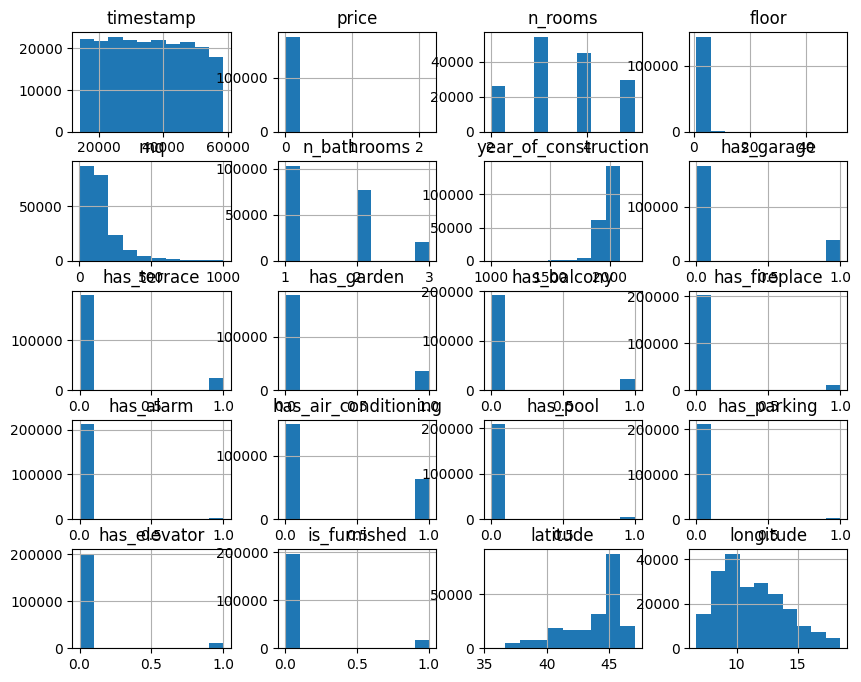

In [7]:
fig = data.hist(figsize=(10, 8))
plt.show()

In [8]:
# Mostrar los valores únicos para cada columna categórica
for col in cat_col:
    print(f"Columna: {col}")
    print(f"Número de valores distintos: {data[col].nunique()}")
    print(f"Valores únicos: {data[col].unique()}")
    print("\n")

Columna: location
Número de valores distintos: 7023
Valores únicos: ['siculiana' 'strongoli' 'zelbio' ... 'adelfia' 'alberobello' 'altamura']


Columna: title
Número de valores distintos: 190951
Valores únicos: ['villa unifamiliare via campo spoto 38, siculiana'
 'quadrilocale contrada tronga 211, tronca, strongoli'
 'bilocale buono stato, piano terra, zelbio' ...
 'villa unifamiliare via antonio quaranta 52 e 54, carbonara di bari, bari'
 'trilocale via niccolò pizzoli, libertà, bari'
 "appartamento all'asta contrada quaglia o casagliola, bari"]


Columna: availability
Número de valores distintos: 1
Valores únicos: ['not free / other']


Columna: energy_class
Número de valores distintos: 12
Valores únicos: [nan 'a3' 'g' 'e' 'b' 'a' 'd' 'c' 'f' 'a1' 'a+' 'a4' 'a2']


Columna: status
Número de valores distintos: 1
Valores únicos: ['other']


Columna: heating
Número de valores distintos: 2
Valores únicos: ['autonomous' 'other']




### Descrición de los datos
| Atributo | Descripción | Respuestas / Unidades |
| -------- | ------- | ------- |
| timestamp  | Tiempo en que se recuperó la información | Segundos (en formato Unix) |
| location | Ubicación (ciudad) de la casa | 7023 ciudades |
| title | Titulo de la publicación | 190051 nombres de publicaciones |
| price | Precio de la casa | $ |
| n_rooms | Número de cuartos | 0, 1 |
| floor | Número de pisos | # cardinales |
| mq | Métros cuadrados | m^2 |
| n_bathroom | Número de baños | # cardinales |
| year_of_construction | Año en que se construyó | Año |
| availability | Disponibilidad de la casa | not free / other |
| energy_class | Tipo de energía | nan, a3, g, e, b, a, d, c, f, a1, a+, a4, a2 <br>*La eficiencia va de G (menor eficiencia) a la A4 (mayor eficiencia) |
| status | Estado de la publicación | other |
| heating | Tipo de calefacción | autonomous, other |
| has_garage | Si la casa tiene garage garage | 0, 1 |
| has_terrace | Si la casa tiene terraza | 0, 1 |
| has_garden | Si la casa tiene jardín | 0, 1 |
| has_balcony | Si la casa tiene balcón | 0, 1 |
| has_fireplace | Si la casa tiene chimenea | 0, 1 |
| has_alarm | Si la casa tiene alarma | 0, 1 |
| has_air_conditioning | Si la casa tiene aire acondicionado | 0, 1 |
| has_pool | Si la casa tiene piscina  | 0, 1 |
| has_parking | Si la casa tiene estacionamiento | 0, 1 |
| has_elevator | Si la casa tiene elevador | 0, 1 |
| is_furnished | Si la casa está amueblada | 0, 1 |
| latitude | Coordenadas de latitud de la casa | ° |
| longitude | Coordenadas de longitud de la casa | ° |

Hay un total de **213409** de publicaciones de casa en Italia.
Los datos tienen **26** atributos.
* Cualitativos: 6
* Cuantitativos: 20
   * Clase: ***price***

# 2. Limpieza de datos

### 1. Remoción de valores nulos

In [9]:
# Cuantificación de valores nulos
missing = raw_data.isnull().sum()
missing_col = missing[missing > 0] # Obtener columnas con valores nulos
print("Columnas con valores faltantes\n",missing_col)

Columnas con valores faltantes
 price                   37478
n_rooms                 57848
floor                   69102
mq                       3889
n_bathrooms             13804
year_of_construction       10
energy_class              648
latitude                   60
longitude                  60
dtype: int64


In [10]:
# Eliminación de columnas con exceso de valores faltantes (> 20,000)
missing_col = missing_col.drop('price') # Excluir columna "price" por ser la variable objetivo

# Eliminar columnas que tengan más de 20,000 valores faltantes
remove_col = missing_col[missing_col > 20000].index 
data = data.drop(columns=remove_col)

# Eliminar las filas con valores faltantes en las columnas restantes
data = data.dropna()

data.shape

(163438, 24)

### 2. Eliminación de columnas redundantes (irrelevantes)

In [11]:
for col in cat_col:
    print(f"Columna: {col}")
    print(f"Número de valores distintos: {data[col].nunique()}")
    print(f"Valores únicos: {data[col].unique()}")
    print("\n")

Columna: location
Número de valores distintos: 6996
Valores únicos: ['zumpano' 'zafferana etnea' 'vinchiaturo' ... 'adelfia' 'alberobello'
 'altamura']


Columna: title
Número de valores distintos: 151470
Valores únicos: ['appartamento via alcide de gasperi 7, zumpano'
 'quadrilocale via san pasquale   19, zumpano'
 'rustico via monte pomiciaro, zafferana etnea' ...
 'bilocale via nazionale 12, palese, bari'
 'villa unifamiliare via antonio quaranta 52 e 54, carbonara di bari, bari'
 'trilocale via niccolò pizzoli, libertà, bari']


Columna: availability
Número de valores distintos: 1
Valores únicos: ['not free / other']


Columna: energy_class
Número de valores distintos: 12
Valores únicos: ['e' 'd' 'g' 'b' 'c' 'a' 'f' 'a1' 'a3' 'a+' 'a4' 'a2']


Columna: status
Número de valores distintos: 1
Valores únicos: ['other']


Columna: heating
Número de valores distintos: 2
Valores únicos: ['autonomous' 'other']




In [12]:
# Eliminación de columnas con un único valor (redundantes)
redundant_col = data.columns[data.nunique() == 1] # Identificar columnas
data = data.drop(columns=redundant_col) # Eliminar columnas
print(f"Columnas eliminadas: {', '.join(redundant_col)}")

Columnas eliminadas: availability, status


In [13]:
# Otras columnas redundantes
# Title: tiene casi tantos valores (categóricos) como el número de instancias, por lo que se considera irrelevante
# Timestamp: De manera similar, existen tantos valores (numéricos) como número de instancias, por lo que se considera irrelevante
data = data.drop(columns=['title','timestamp'])
data.shape

(163438, 20)

In [14]:
# Categorical columns
cat_col = [col for col in data.columns if data[col].dtype == 'object']
print('Categorical columns :',cat_col)

Categorical columns : ['location', 'energy_class', 'heating']


### 3. Remoción de outliers

In [15]:
fig = make_subplots(rows=1, cols=4,
                    specs=[[{'type':'box'}, {'type':'box'}, {'type':'box'}, {'type':'box'}]],
                    subplot_titles=("mq", "Year of Construction", "Latitude", "Longitude"))

fig.add_trace(go.Box(y=data['mq'], name="Square meters"), row=1, col=1)
fig.add_trace(go.Box(y=data['year_of_construction'], name="Year of Constrution"), row=1, col=2)
fig.add_trace(go.Box(y=data['latitude'], name="Latitude"), row=1, col=3)
fig.add_trace(go.Box(y=data['longitude'], name="Longitude"), row=1, col=4)

fig.show()

In [16]:
# Remoción de outliers para atributo mq
mean = data['mq'].mean()
std  = data['mq'].std()

lower_bound = mean - std*2
upper_bound = mean + std*2

data = data[(data['mq'] >= lower_bound)
                & (data['mq'] <= upper_bound)]

In [17]:
# Remoción de outliers para atributo Year of Construction
mean = data['year_of_construction'].mean()
std  = data['year_of_construction'].std()
 
lower_bound = mean - std*2
upper_bound = mean + std*2
 
data = data[(data['year_of_construction'] >= lower_bound)
                & (data['year_of_construction'] <= upper_bound)]

In [18]:
fig = make_subplots(rows=1, cols=4,
                    specs=[[{'type':'box'}, {'type':'box'}, {'type':'box'}, {'type':'box'}]],
                    subplot_titles=("mq", "Year of Construction", "Latitude", "Longitude"))

fig.add_trace(go.Box(y=data['mq'], name="Square meters"), row=1, col=1)
fig.add_trace(go.Box(y=data['year_of_construction'], name="Year of Constrution"), row=1, col=2)
fig.add_trace(go.Box(y=data['latitude'], name="Latitude"), row=1, col=3)
fig.add_trace(go.Box(y=data['longitude'], name="Longitude"), row=1, col=4)

fig.show()

## 3. Análisis exploratorio de datos limpios

### Visualización de los datos cuantitativos

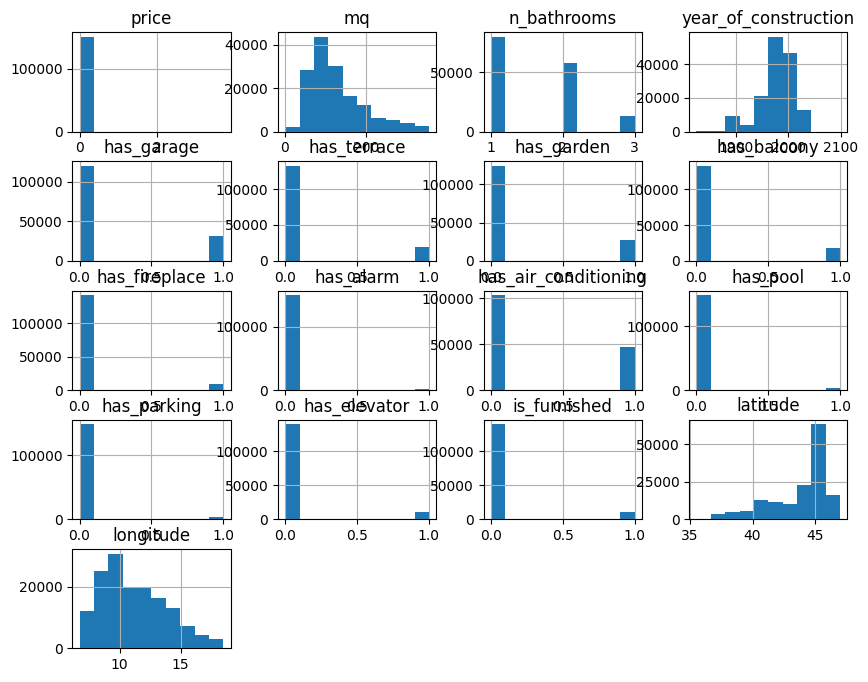

In [19]:
fig = data.hist(figsize=(10, 8)) # Modificar tamaño de los graficos para que se aprecien mejor
plt.show() # Muestra los graficos

### Visualización de los datos cualitativos

In [20]:
# Categorical Values
# Location
l_L = data['location'].value_counts().head(10).index
v_L = data['location'].value_counts().head(10).values

# Energy Class
l_EC = data['energy_class'].value_counts().head(5).index
v_EC = data['energy_class'].value_counts().head(5).values

# Heating
l_H = data['heating'].value_counts().index
v_H = data['heating'].value_counts().values


In [21]:
# Visualizar en gráficos de barras
fig = make_subplots(rows=1, cols=3,
                    specs=[[{'type':'bar'}, {'type':'bar'}, {'type':'bar'}]],
                    subplot_titles=("Location", "Energy Class", "Heating"))

fig.add_trace(go.Bar(x=l_L, y=v_L, name="location"), row=1, col=1)
fig.add_trace(go.Bar(x=l_EC, y=v_EC, name="energy_class"), row=1, col=2)
fig.add_trace(go.Bar(x=l_H, y=v_H, name="heating"), row=1, col=3)

fig.update_layout(
    height=800,  
    width=1200, 
    margin=dict(t=50, b=150), 
)
fig.update_xaxes(tickangle=45)  

fig.show()

- ***Location*** tiene una distribución más pareja entre todos los valores.
- ***Energy Class*** y ***Heating*** tienen valores muy cargados en una sola respuesta. 

## 4. Extracción de características

### 1. Asignación de zonas geográficas

In [22]:
# Función para clasificar zonas de Italia
def zone_classification(lat, lon):
    if lat > 44:
        return 'Nord'
    elif 41 <= lat <= 44:
        return 'Centro'
    elif lat < 41:
        return 'Sud'
    else:
        return 'Altre aree'

data['zone'] = data.apply(lambda row: zone_classification(row['latitude'], row['longitude']), axis=1)

In [23]:
data['zone'].describe()

count     150775
unique         3
top         Nord
freq       95208
Name: zone, dtype: object

In [24]:
# Eliminar columna de location, latitue, y longitud, por tener demasiados valores unicos, y con la nueva columna 'zone' se vuelven redundantes
data = data.drop(columns=['location', 'latitude','longitude'])

### 2. Asignación de niveles de eficiencia energética

In [25]:
def classify_efficiency(energy_class):
    if energy_class in ['g', 'f', 'e']:
        return 'Bassa'
    elif energy_class in ['d', 'c', 'b']:
        return 'Moderata'
    else:
        return 'Alta'

data['efficiency_level'] = data['energy_class'].apply(classify_efficiency)
data = data.drop(columns=['energy_class'])
data['efficiency_level'].describe()

count     150775
unique         3
top        Bassa
freq      112042
Name: efficiency_level, dtype: object

## 5. Selección de características

In [26]:
cat_col = [col for col in data.columns if data[col].dtype == 'object']
print('Categorical columns :',cat_col)

for col in cat_col:
    print(f"Columna: {col}")
    print(f"Número de valores distintos: {data[col].nunique()}")
    print(f"Valores únicos: {data[col].unique()}")
    print("\n")

Categorical columns : ['heating', 'zone', 'efficiency_level']
Columna: heating
Número de valores distintos: 2
Valores únicos: ['autonomous' 'other']


Columna: zone
Número de valores distintos: 3
Valores únicos: ['Sud' 'Centro' 'Nord']


Columna: efficiency_level
Número de valores distintos: 3
Valores únicos: ['Bassa' 'Moderata' 'Alta']




In [27]:
# Transformación de variables categóricas a numéricas
replace_dict = {'other': '0', 'autonomous': '1', 'Centro' : '0', 'Nord': '1', 'Sud': '2', 'Altre aree': '3', 'Bassa': '0', 'Moderata': '1', 'Alta': '2'}

data['heating'] = data['heating'].replace(replace_dict)
data['zone'] = data['zone'].replace(replace_dict)
data['efficiency_level'] = data['efficiency_level'].replace(replace_dict)

print(data.head())

       price     mq  n_bathrooms  year_of_construction heating  has_garage  \
10   90000.0  124.0          2.0                2002.0       1           0   
13   59000.0  127.0          1.0                2001.0       1           0   
15   65000.0   45.0          1.0                1950.0       1           0   
16  120000.0   45.0          1.0                1900.0       1           0   
17   22000.0   70.0          1.0                1900.0       1           0   

    has_terrace  has_garden  has_balcony  has_fireplace  has_alarm  \
10            0           0            0              0          0   
13            0           0            0              1          0   
15            0           0            0              0          0   
16            0           0            0              1          0   
17            0           0            0              0          0   

    has_air_conditioning  has_pool  has_parking  has_elevator  is_furnished  \
10                     0       

### 1. Ganancia de información

In [29]:
X = data.drop('price', axis=1)
y = data['price']

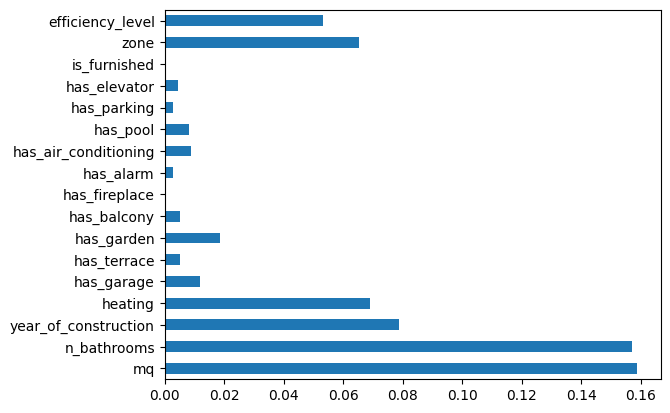

In [30]:
X_new = mutual_info_classif(X, y)
feat_imp = pd.Series(X_new, X.columns[0:len(X.columns)])
feat_imp.plot(kind='barh')
plt.show()

Las características seleccionadas son: **n_bathrooms**, **mq**, **year_of_construction**, **zone**, **heating** y **efficiency_level**

### 2. Forward selection

In [31]:
lr = LinearRegression()

ffs = SequentialFeatureSelector(lr, n_features_to_select=5, direction='forward')
ffs.fit(X, y)

selected_features = ffs.get_support()
print('Las características seleccionadas son:', list(X.columns[selected_features]))

Las características seleccionadas son: ['mq', 'n_bathrooms', 'year_of_construction', 'has_pool', 'efficiency_level']


De acuerdo con los analisis de selección de características, los atributos que se seleccionaron son:
1. mq
2. n_bathrooms
3. year_of_construction
4. zone
5. heating
6. efficiency_level
7. has_garden
8. has_pool

**Nota:** La desición final podría cambiar después de evaluar el modelo

## 6. Modelos de regresión

In [32]:
# Function to evaluate models and plot predictions
def evaluate_model(model, X_train, X_test, y_train, y_test, model_name):
    model.fit(X_train, y_train)
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    
    print(f'Model: {model_name}')
    print(f'Train R^2: {r2_score(y_train, y_pred_train):.4f}')
    print(f'Test R^2: {r2_score(y_test, y_pred_test):.4f}')
    print(f'Test RMSE: {np.sqrt(mean_squared_error(y_test, y_pred_test)):.4f}')
    print('-'*40)
    
    # Plot the predictions vs real values
    plt.figure(figsize=(4, 4))
    plt.scatter(y_test, y_pred_test, label='Predictions', color='blue')
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
    plt.xlabel('Actual Values')
    plt.ylabel('Predicted Values')
    plt.title(f'Actual vs Predicted - {model_name}')
    plt.legend()
    plt.show()

### 1. Evaluación con partición local

In [33]:
dropped_col = ['price','has_air_conditioning','has_garage','has_terrace','has_balcony','is_furnished']

In [34]:
X = data.drop(columns=dropped_col, axis=1)
y = data['price']

In [35]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Model: Linear Regression
Train R^2: 0.0025
Test R^2: 0.0131
Test RMSE: 654038.9367
----------------------------------------


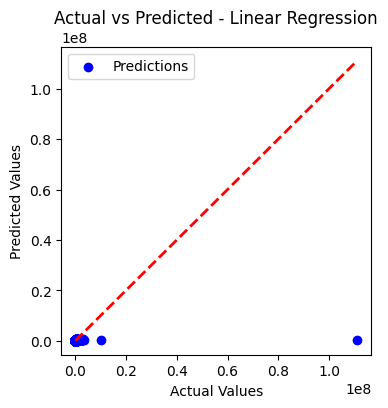

Model: Ridge Regression
Train R^2: 0.0025
Test R^2: 0.0131
Test RMSE: 654038.8848
----------------------------------------


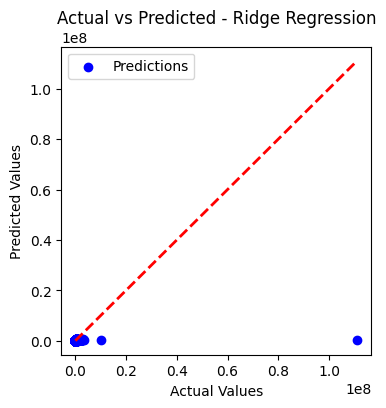

Model: Lasso Regression
Train R^2: 0.0025
Test R^2: 0.0131
Test RMSE: 654038.9290
----------------------------------------


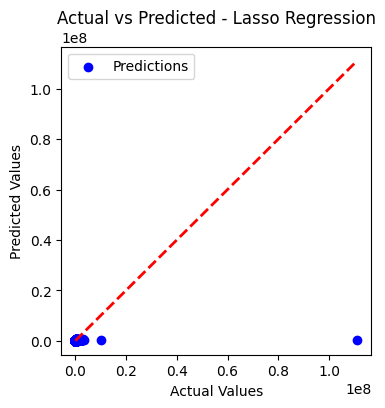

Model: Random Forest Regression
Train R^2: 0.2847
Test R^2: -0.1122
Test RMSE: 694321.5742
----------------------------------------


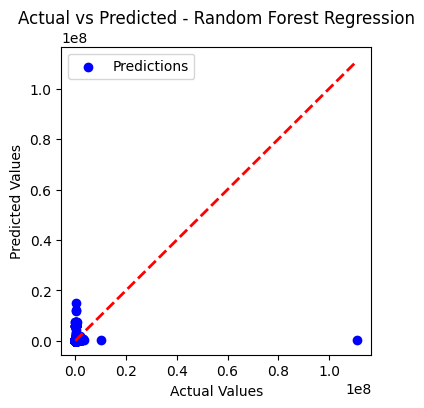

In [36]:
# 1. Linear Regression
linear_reg = LinearRegression()
evaluate_model(linear_reg, X_train, X_test, y_train, y_test, 'Linear Regression')

# 2. Ridge Regression
ridge_reg = Ridge(alpha=1.0)
evaluate_model(ridge_reg, X_train, X_test, y_train, y_test, 'Ridge Regression')

# 3. Lasso Regression
lasso_reg = Lasso(alpha=0.1)
evaluate_model(lasso_reg, X_train, X_test, y_train, y_test, 'Lasso Regression')

# 4. Random Forest Regression
rf_reg = RandomForestRegressor(n_estimators=100, random_state=42)
evaluate_model(rf_reg, X_train, X_test, y_train, y_test, 'Random Forest Regression')

### 2. Evaluación datos de prueba

In [37]:
data_test = pd.read_csv('test_housing_data_italy.csv')

In [38]:
# Añadir atributo de 'zone'
data_test['zone'] = data_test.apply(lambda row: zone_classification(row['latitude'], row['longitude']), axis=1)

# Añadir atributo de 'efficiency_level'
data_test['efficiency_level'] = data_test['energy_class'].apply(classify_efficiency)

# Eliminar columnas innecesarias
data_test = data_test.drop(columns=['n_rooms','floor','availability','status','title','timestamp','latitude','longitude', 'location','energy_class'])

# Eliminar valores nulos
data_test = data_test.dropna()

replace_dict = {'other': '0', 'autonomous': '1', 'Centro' : '0', 'Nord': '1', 'Sud': '2', 'Altre aree': '3', 'Bassa': '0', 'Moderata': '1', 'Alta': '2'}
data_test['heating'] = data_test['heating'].replace(replace_dict)
data_test['zone'] = data_test['zone'].replace(replace_dict)
data_test['efficiency_level'] = data_test['efficiency_level'].replace(replace_dict)
data_test.shape

(7845, 18)

In [39]:
dropped_col = ['price','has_air_conditioning','has_garage','has_terrace','has_balcony','is_furnished']

In [40]:
X_train = data.drop(columns=dropped_col)
y_train = data['price']
X_test = data_test.drop(columns=dropped_col)
y_test = data_test['price']

Model: Linear Regression
Train R^2: 0.0029
Test R^2: 0.2162
Test RMSE: 140030.4242
----------------------------------------


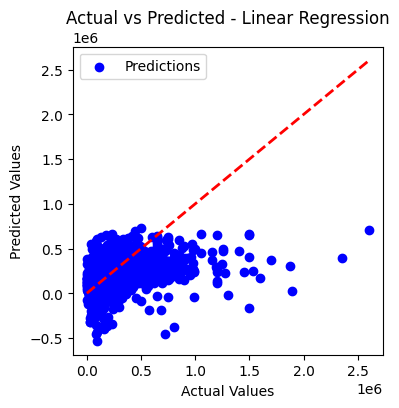

Model: Ridge Regression
Train R^2: 0.0029
Test R^2: 0.2162
Test RMSE: 140031.2029
----------------------------------------


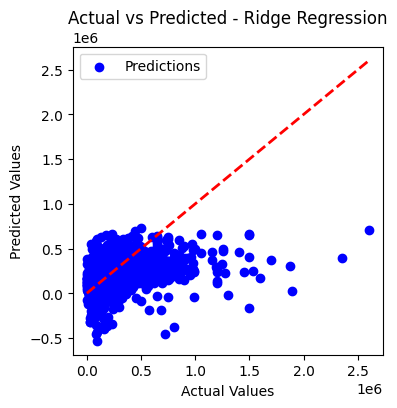

Model: Lasso Regression
Train R^2: 0.0029
Test R^2: 0.2162
Test RMSE: 140030.5907
----------------------------------------


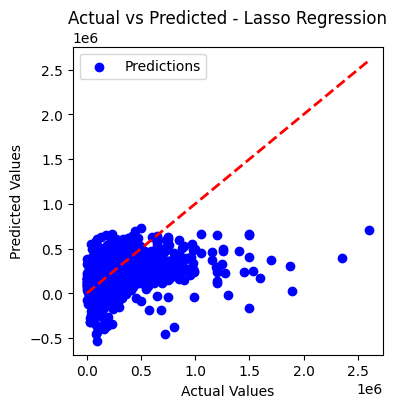

Model: Random Forest Regression
Train R^2: 0.3294
Test R^2: -0.9659
Test RMSE: 221764.5453
----------------------------------------


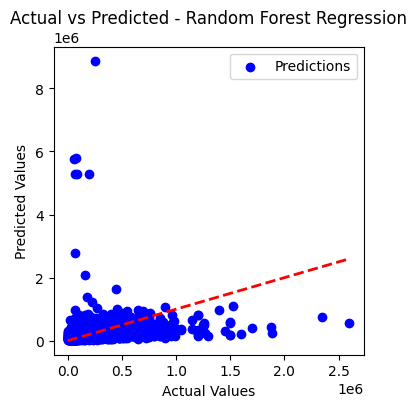

In [41]:
# 1. Linear Regression
linear_reg = LinearRegression()
evaluate_model(linear_reg, X_train, X_test, y_train, y_test, 'Linear Regression')

# 2. Ridge Regression
ridge_reg = Ridge(alpha=1.0)
evaluate_model(ridge_reg, X_train, X_test, y_train, y_test, 'Ridge Regression')

# 3. Lasso Regression
lasso_reg = Lasso(alpha=0.1)
evaluate_model(lasso_reg, X_train, X_test, y_train, y_test, 'Lasso Regression')

# 4. Random Forest Regression
rf_reg = RandomForestRegressor(n_estimators=100, random_state=42)
evaluate_model(rf_reg, X_train, X_test, y_train, y_test, 'Random Forest Regression')

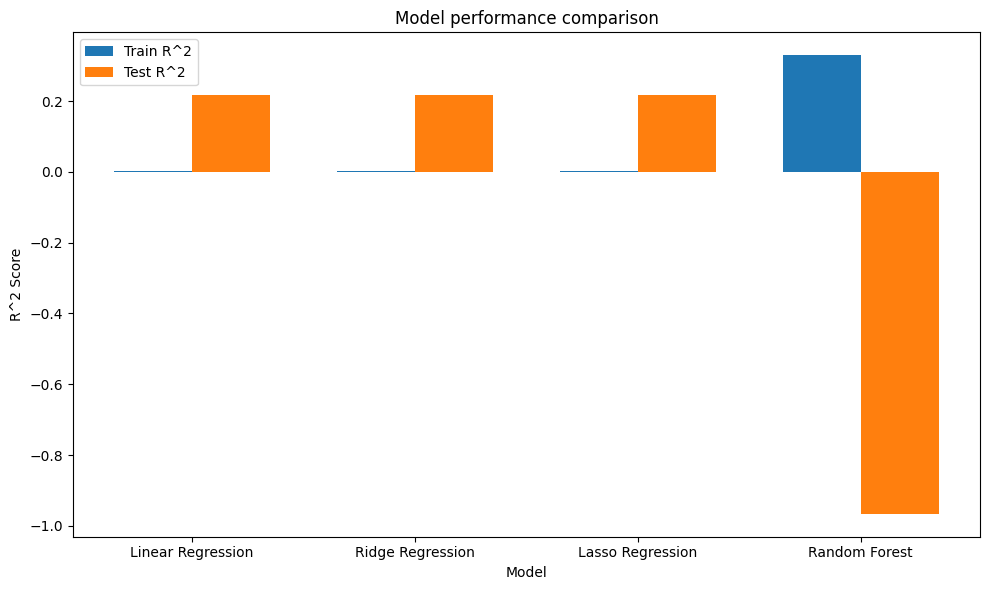

In [42]:
# Compare model performance based on R^2 scores for training and testing sets
models = ['Linear Regression', 'Ridge Regression', 'Lasso Regression', 'Random Forest']
train_scores = [
    r2_score(y_train, linear_reg.predict(X_train)),
    r2_score(y_train, ridge_reg.predict(X_train)),
    r2_score(y_train, lasso_reg.predict(X_train)),
    r2_score(y_train, rf_reg.predict(X_train))
]
test_scores = [
    r2_score(y_test, linear_reg.predict(X_test)),
    r2_score(y_test, ridge_reg.predict(X_test)),
    r2_score(y_test, lasso_reg.predict(X_test)),
    r2_score(y_test, rf_reg.predict(X_test))
]

# Bar plot comparing R^2 score for all models
fig, ax = plt.subplots(figsize=(10, 6))
index = np.arange(len(models))
bar_width = 0.35

bar1 = ax.bar(index, train_scores, bar_width, label='Train R^2')
bar2 = ax.bar(index + bar_width, test_scores, bar_width, label='Test R^2')

ax.set_xlabel('Model')
ax.set_ylabel('R^2 Score')
ax.set_title('Model performance comparison')
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(models)
ax.legend()

plt.tight_layout()
plt.show()

In [43]:
# Example code: Multivariate Regression with multiple features
X_multi = data.drop('price', axis=1)
y = data['price']
X_train, X_test, y_train, y_test = train_test_split(X_multi, y, test_size=0.2, random_state=42)

linear_reg = LinearRegression()
linear_reg.fit(X_train, y_train)
y_pred = linear_reg.predict(X_test)

print(f'R^2: {r2_score(y_test, y_pred)}')

R^2: 0.012762432095669851


In [44]:
# Example code: Multivariate Regression with multiple features
X_multi = data[['mq']]
y = data['price']
X_train, X_test, y_train, y_test = train_test_split(X_multi, y, test_size=0.2, random_state=42)

linear_reg = LinearRegression()
linear_reg.fit(X_train, y_train)
y_pred = linear_reg.predict(X_test)

print(f'R^2: {r2_score(y_test, y_pred)}')

R^2: 0.008209340714440905


## 7. Conclusión

Todos los modelos obtuvieron un R^2 muy bajo. En la mayoría de casos el R^2 de entrenamiento fue excesivamente bajo comparado con el de prueba. Unicamente con el modelo Random Forest se obtuvo un mayor R^2 de entrenamiento (0.3294), pero el R^2 de prueba fue incluso negativo.

Solo se reportaron los mejores resultados de R^2 de acuerdo a la mejor selección de características, independientemente de lo que sugirieron los algoritmos de selección. No obstante, otras combinaciones con menos características dieron resultados muy similares. Considero que estos modelos eran mejores por ser más simples, sin embargo, decidí solo reportar el que diera el número de R^2 más alto.

Creo que algunas cosas que pudieron mejorar los resultados es una mejor extracción de características, no haber eliminado tantas instancias, o quizá otras maneras de transformar los datos. Aunque no exploré todos los modelos de regresión disponible, ni manipulé todos los parámetros, dudo que hubiera tan satisfactorio. 

A pesar de los resultados, creo que un modelo diferente que no sea regresión si podría encontrar alguna respuesta satisfactoria. Me gustaría volver a intentar resolver el problema una vez que explore otros modelos.